<a href="https://colab.research.google.com/github/rabbiyariaz/AudibleScrape/blob/main/News_Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **News Classifier**

## **Machine Learning Project**

## Data inspection

### Import libraries

In [9]:
# All the basic imports will appear here

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import nltk
from nltk.corpus import stopwords

import re

#### Information about libraries
1. pandas: for data manipulation and analysis.
2. matplotlib.pyplot:  for the creating static, animated, and interactive visualizations.
3. seaborn: is a popular data visualization library.
4. Counter: count the occurrences of elements in an iterable, such as lists, strings, or tuples returns the counts as a dictionary-like object.
5. nltk: Natural Language Toolkit for working with human language data.
6. stopwords: Stopwords are words that occur frequently in a language but do not carry much meaningful information for certain tasks, such as text classification or keyword extraction. Examples in English: "a," "an," "the," "is," "are," "in," "on."
7. re: regular expression (regex) module which allows you to work with text patterns, search for, match, or replace parts of strings using regular expressions.
8. TensorFlow, an open-source software library developed by Google for numerical computation and machine learning.

In [10]:
#test - to be removed

import tensorflow as tf
print("TensorFlow version:", tf.__version__)
print("GPU is available:", tf.config.list_physical_devices('GPU'))

TensorFlow version: 2.17.1
GPU is available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


#### Download the stopwords

In [11]:
#This download is being done for this module: Inspection check that checks what words are the most common in each category

# Download NLTK stop words if you haven't done so
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))
print(stop_words) # set

{'those', "wasn't", 'hasn', 'weren', 'an', 'some', 'shan', 'more', 'himself', "you're", "you'd", 'before', "she's", 'are', 'ma', "should've", 've', 'mightn', 'so', 'didn', 'it', 'its', 'out', 'only', 'mustn', 'off', "doesn't", 'themselves', "it's", 'here', 'our', 'ain', 's', 'with', 'doesn', 'wasn', "needn't", 'hers', "that'll", "isn't", "don't", 'when', 'once', 'm', 'ours', 'other', 'having', 'being', "shouldn't", 'which', 'both', 'he', 'very', 'isn', 'wouldn', 'where', "aren't", 'while', 'is', 'did', 'no', "won't", "couldn't", "weren't", 'you', 'will', 'i', 'them', 'further', 'below', 'shouldn', "you've", 're', 'at', 'into', 'on', 'does', 'do', 'what', 'that', 'yourselves', 'about', 'couldn', 'who', 'because', 'through', 'not', 'but', 'and', 'after', 'just', 'me', "didn't", 'down', 'any', 'this', 't', 'few', 'him', 'has', 'against', 'all', 'they', 'these', 'my', "mightn't", 'have', 'aren', "hadn't", 'between', 'than', "hasn't", 'until', 'herself', 'then', 'needn', 'be', 'why', 'can',

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


#### Configuring Pandas Display Options to Show All Rows, Columns, and Full Content.








In [12]:
# Display all things / Changed from Default
pd.options.display.max_columns = None
pd.options.display.max_rows = None
pd.options.display.max_colwidth = None
# We will now see all rows, all columns, and full content in the DataFrame. This is useful for inspecting data when you need to view the entire DataFrame at once.

In [13]:
#In order to go back to Default mode try this:
#pd.reset_option('display.max_columns')
#pd.reset_option('display.max_rows')
#pd.reset_option('display.max_colwidth')

### Upload the data

In [14]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [15]:
df = pd.read_csv('/content/drive/MyDrive/output_file.csv')
print(df)

In [16]:
# #You will have to upload the .CSV each time because its only Runtime loaded considering certain factors

# from google.colab import files
# uploaded = files.upload()

In [17]:
# # Load the CSV from the uploaded file
# import io
# df = pd.read_csv(io.BytesIO(uploaded['output_file.csv']) , low_memory=False)

#### Understanding the Data

In [18]:
df.sample(10)

In [19]:
# data info
print(df.info())

In [20]:
# describe the data
print(df.describe(include='all'))

In [21]:
# count the missing values
missing_values = df.isnull().sum()
print("Missing values:\n", missing_values[missing_values > 0])

In [22]:
#One of the technique to deal with these missing values/authors
#Fill missing authors with 'Unknown'
#df['authors'].fillna('Unknown', inplace=True)

In [23]:
#Need to be reviewed
#Fill missing values
df = df.fillna({
    'headline': 'No Headline',
    'short_description': 'No Description',
    'authors': 'Unknown Author'
})


In [24]:
# Unique values
unique_values = df.nunique()
print("Unique values:\n", unique_values)

##### Find the duplicate samples

In [45]:
# We will check if there any duplicate samples
duplicate_rows = df[df.duplicated(subset=['short_description'], keep=False)]

# Display the number of duplicate rows
print(f"Number of duplicate rows based on 'description': {len(duplicate_rows)}")

# Optionally, display the duplicate rows to inspect them
print(duplicate_rows)



Streaming output truncated to the last 5000 lines.
127516                                                                                                                                                                                                                                                                                                                                                                                                                                                                          Several Injured In Gunfire On Famed New Orleans Street No Description  
127518                                                                                                                                                                                                                                                                                                                                                                                                                       

#### Visualize the category distribution

In [26]:
# Seeing Distribution of categories using a Histogram
plt.figure(figsize=(12, 8))
sns.countplot(y=df['category'], order=df['category'].value_counts().index)
plt.title('Category Distribution')
plt.show()

#### Here I am  creating the copy of the dataframe and then add columns in the copied dataframe, I am not modifying the original dataframe. So we can check simultaneously whether there is need of adding these columns

In [27]:
# Create a copy of the original DataFrame
df_copy = df.copy()

# Add new feature columns to the copy
# The length of headlines and short_description is based on the count of words.
df_copy['headline_length'] = df_copy['headline'].apply(lambda x: len(str(x).split()))
df_copy['short_desc_length'] = df_copy['short_description'].apply(lambda x: len(str(x).split()))

print(df_copy.head())

In [28]:
# df['headline_length'] = df['headline'].apply(lambda x: len(str(x).split()))
# df['short_desc_length'] = df['short_description'].apply(lambda x: len(str(x).split()))

##### interesting inspection check for relation on Original **data**

In [29]:
##An interesting inspection check for relation between lengths of short descriptions and category
##Group by category and calculate descriptive statistics
# category_stats = df.groupby('category')['short_desc_length'].describe()
# print(category_stats)

##### interesting inspection check for relation on copied **data**

In [30]:
# An interesting inspection check for relation between lengths of short descriptions and category
# Group by category and calculate descriptive statistics
category_stats = df_copy.groupby('category')['short_desc_length'].describe()
print(category_stats)

##### Original data Visualization

In [31]:
# plt.figure(figsize=(12, 8))
# print(df.head())
# sns.boxplot(x='short_desc_length', y='category', data=df)
# plt.title('Distribution of Short Description Length by Category')
# plt.xlabel('Short Description Length (Word Count)')
# plt.ylabel('Category')
# plt.show()

##### copy data Visualization

In [32]:
plt.figure(figsize=(12, 8))
sns.boxplot(x='short_desc_length', y='category', data=df_copy)
plt.title('Distribution of Short Description Length by Category')
plt.xlabel('Short Description Length (Word Count)')
plt.ylabel('Category')
plt.show()

##### Mean length original **data**

In [33]:
# # Calculate mean length per category
# mean_length_by_category = df.groupby('category')['short_desc_length'].mean().sort_values()

# plt.figure(figsize=(12, 8))
# mean_length_by_category.plot(kind='barh')
# plt.title('Average Short Description Length by Category')
# plt.xlabel('Average Short Description Length (Word Count)')
# plt.ylabel('Category')
# plt.show()

##### Mean length copy **data**

In [34]:
# Calculate mean length per category
mean_length_by_category = df_copy.groupby('category')['short_desc_length'].mean().sort_values()

plt.figure(figsize=(12, 8))
mean_length_by_category.plot(kind='barh')
plt.title('Average Short Description Length by Category')
plt.xlabel('Average Short Description Length (Word Count)')
plt.ylabel('Category')
plt.show()

In [35]:

#An interesting inspection check for relation between lengths of short descriptions and category
#Ends (Well I believe there is a relation and this can act as a feature or assist us in classification)

##### histogram original data

In [36]:
# # Plot text lengths
# plt.figure(figsize=(12, 5))
# sns.histplot(df['headline_length'], bins=30, kde=True)
# plt.title('Headline Length Distribution')
# plt.xlabel('Number of Words')
# plt.show()

# plt.figure(figsize=(12, 5))
# sns.histplot(df['short_desc_length'], bins=30, kde=True)
# plt.title('Short Description Length Distribution')
# plt.xlabel('Number of Words')
# plt.show()

##### histogram copy data

In [37]:
# Plot text lengths
plt.figure(figsize=(12, 5))
sns.histplot(df_copy['headline_length'], bins=30, kde=True)
plt.title('Headline Length Distribution')
plt.xlabel('Number of Words')
plt.show()

plt.figure(figsize=(12, 5))
sns.histplot(df_copy['short_desc_length'], bins=30, kde=True)
plt.title('Short Description Length Distribution')
plt.xlabel('Number of Words')
plt.show()

#### Most comman words in each category

In [38]:
#Another inspection check that checks what words are the most common in each category

# Function to clean and tokenize text
def preprocess_text(text):
    # Remove punctuation and convert to lower case
    text = re.sub(r'[^\w\s]', '', text.lower())
    # Tokenize and filter out stop words
    words = text.split()
    return [word for word in words if word not in stop_words]


Remove punctuation: The re.sub(r'[^\w\s]', '', text.lower()) line removes any characters that aren't alphanumeric or whitespace and converts the text to lowercase. This helps standardize the text for word counting (e.g., "Hello!" and "hello" are treated as the same word).

Tokenize: The split() method splits the cleaned text into words (tokens), assuming that words are separated by spaces.

Remove stop words: The list comprehension [word for word in words if word not in stop_words] filters out any words that are considered "stop words" (e.g., "the", "and", "is"). stop_words is typically a list of common words that do not provide meaningful information for text analysis.



In [46]:
# Create a dictionary to hold word counts per category
word_counts = {}

# Count words in the 'short_description' for each category
for index, row in df.iterrows():
    category = row['category']
    words = preprocess_text(row['short_description'])
    if category not in word_counts:
        word_counts[category] = Counter()

    word_counts[category].update(words)
print(word_counts)

{'U.S. NEWS': Counter({'said': 218, 'new': 107, 'people': 98, 'police': 90, 'us': 79, 'one': 67, 'two': 55, 'state': 48, 'last': 45, 'officials': 44, 'school': 44, 'killed': 43, 'president': 41, 'man': 39, 'say': 38, 'states': 37, 'california': 36, 'shooting': 36, 'year': 36, 'former': 36, 'years': 35, 'could': 35, 'first': 33, 'died': 33, 'health': 32, 'would': 32, 'authorities': 32, 'found': 31, 'fire': 31, 'week': 30, 'city': 29, 'federal': 29, 'death': 29, 'least': 29, 'also': 29, 'covid19': 29, 'national': 28, 'york': 28, 'day': 28, 'may': 26, 'texas': 26, 'officers': 26, 'accused': 25, 'woman': 25, 'reported': 25, 'children': 25, 'shot': 25, 'told': 25, 'black': 24, 'case': 24, 'since': 24, 'saturday': 23, 'students': 23, 'coronavirus': 23, 'according': 22, 'court': 22, 'house': 22, 'sunday': 22, 'help': 22, 'high': 22, 'including': 22, 'home': 22, 'cases': 21, 'three': 21, 'time': 21, 'company': 21, 'friday': 21, 'water': 20, 'like': 20, 'days': 20, 'says': 20, 'virus': 20, 'mon

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


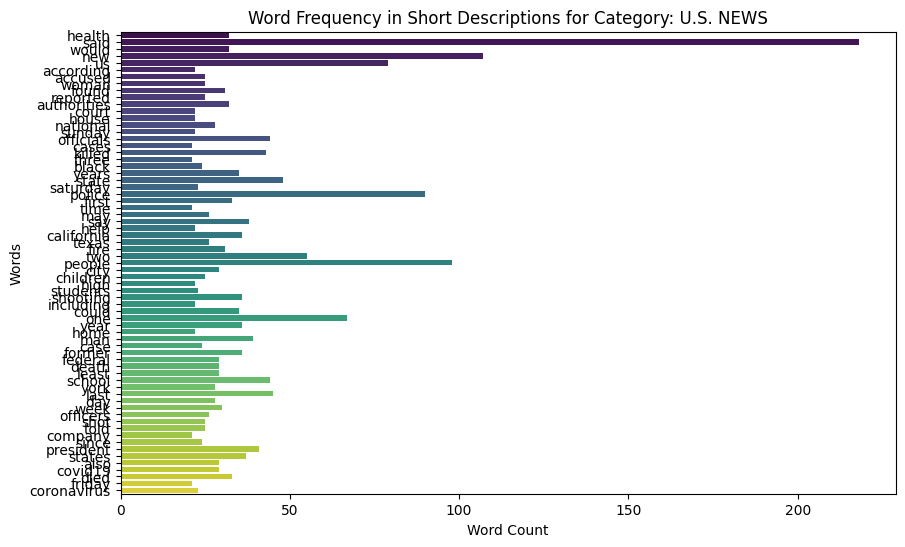

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


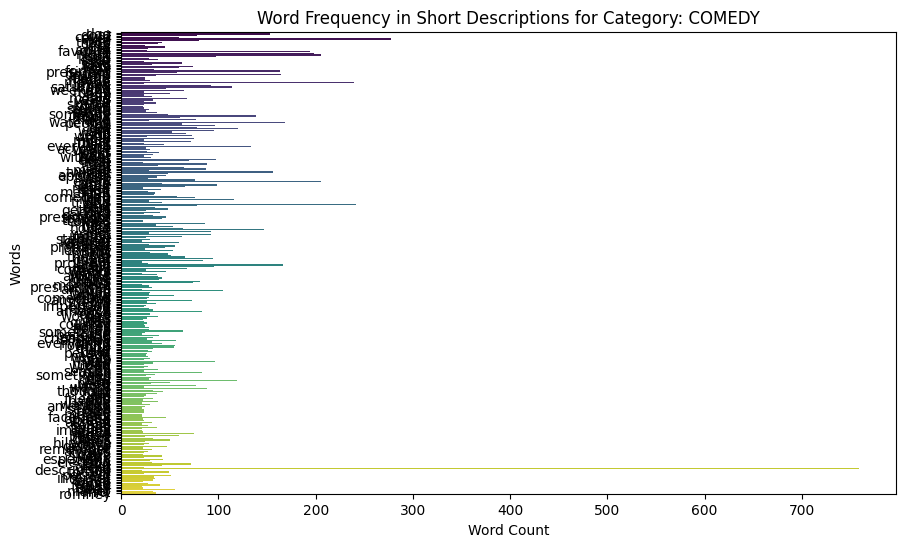

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


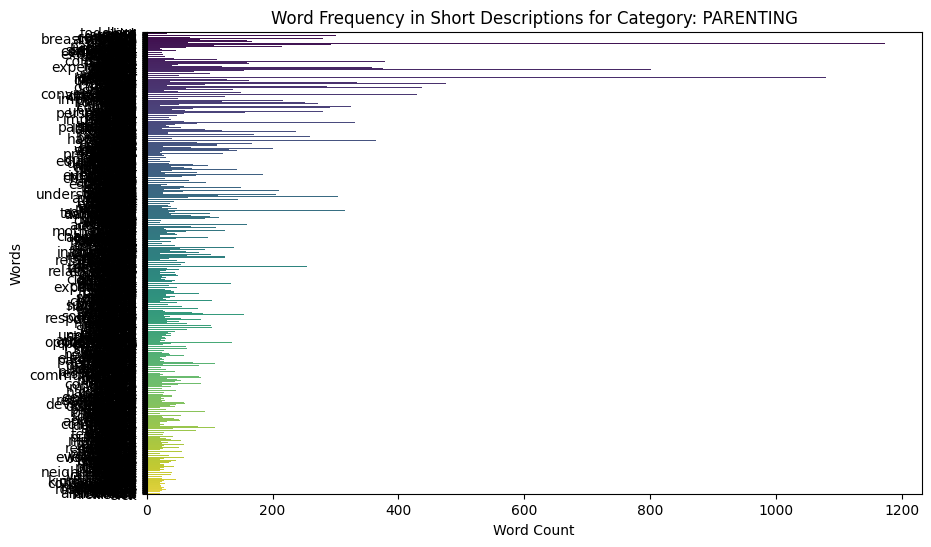

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


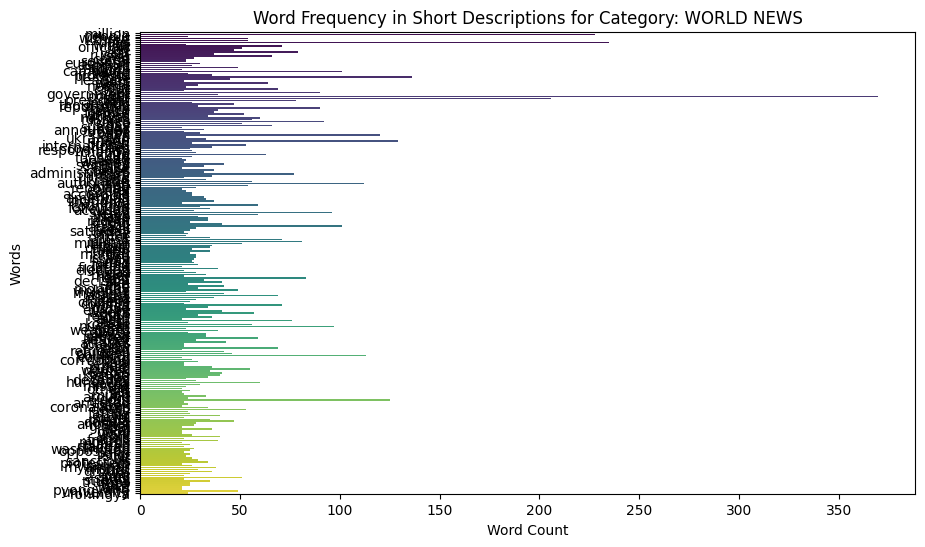

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


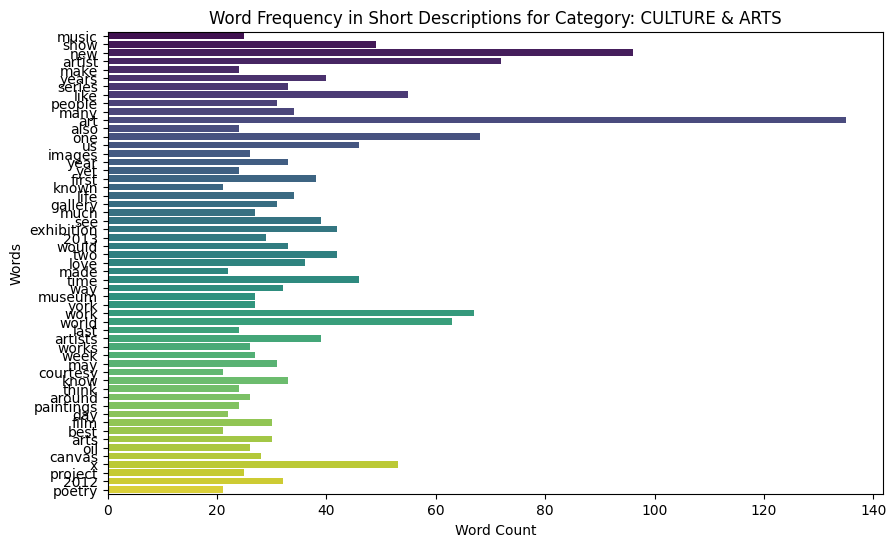

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


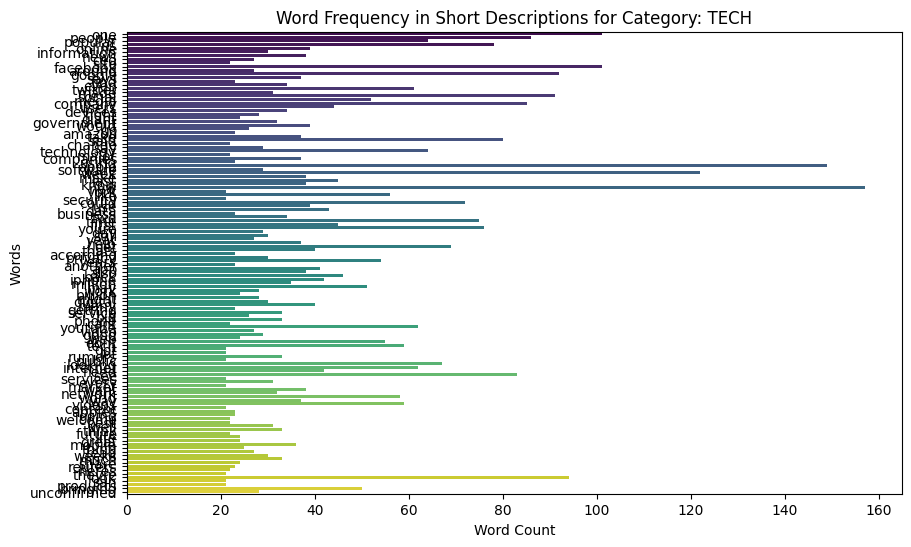

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


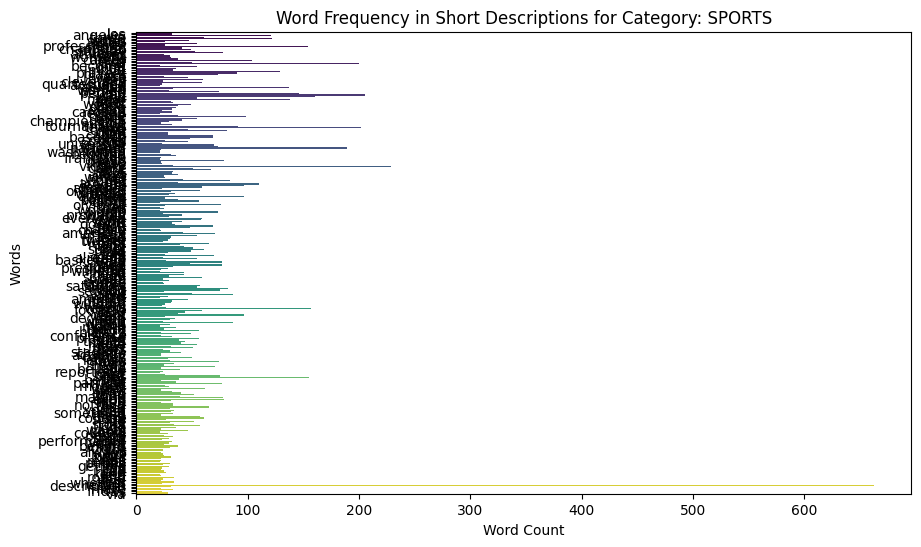

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


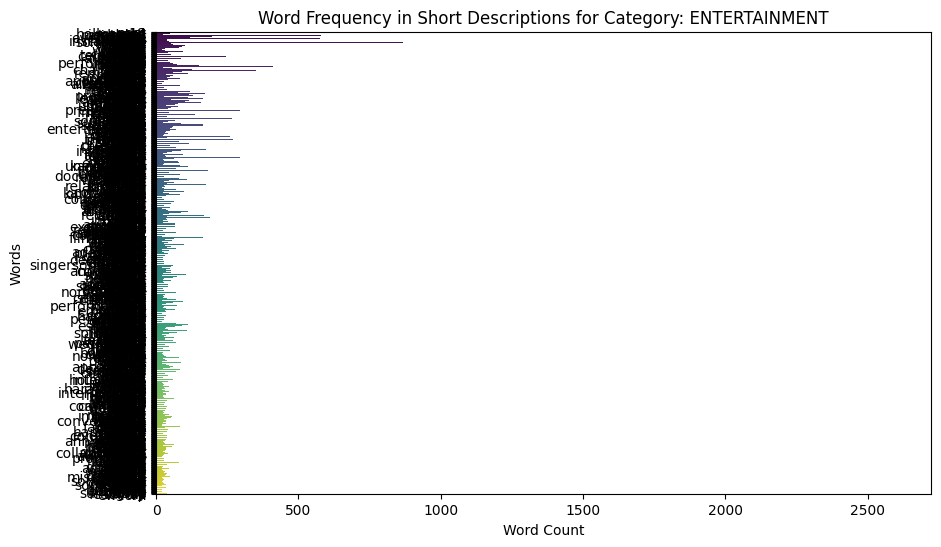

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


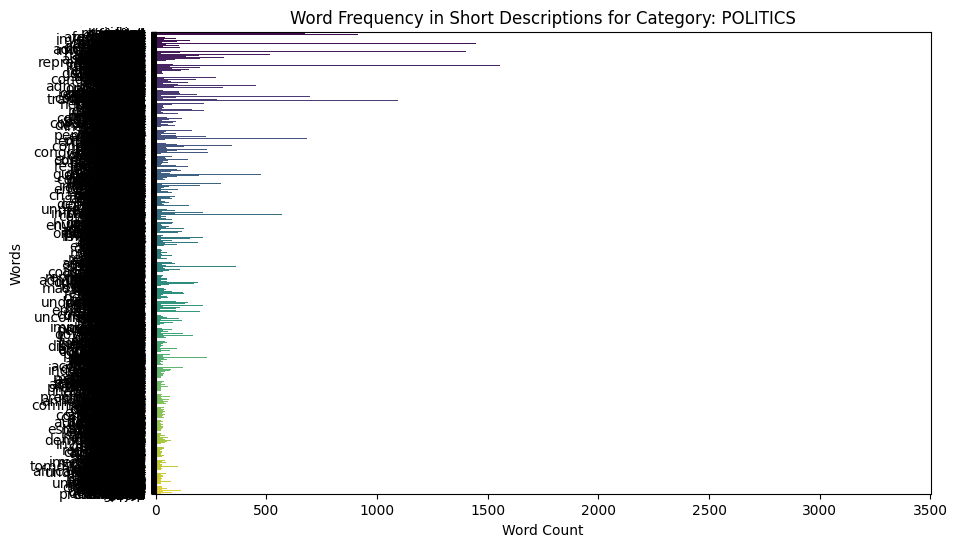

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


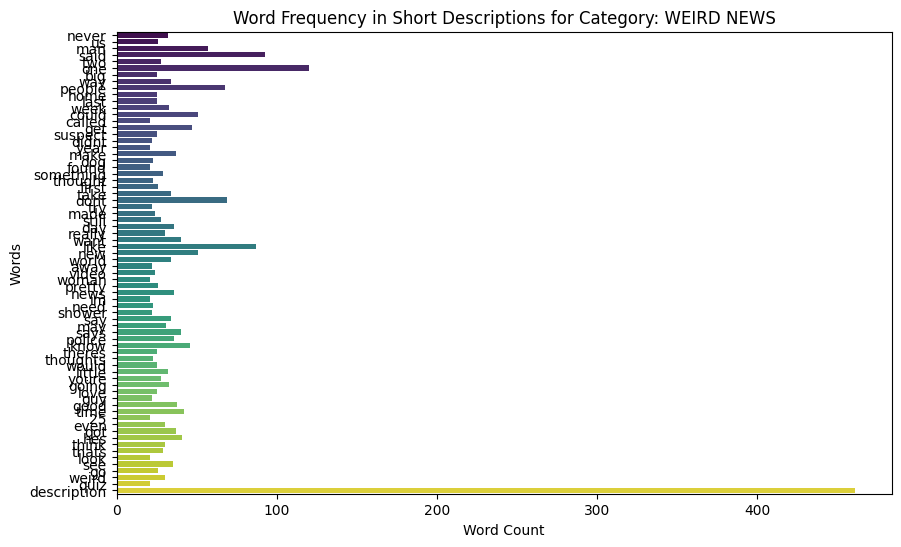

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


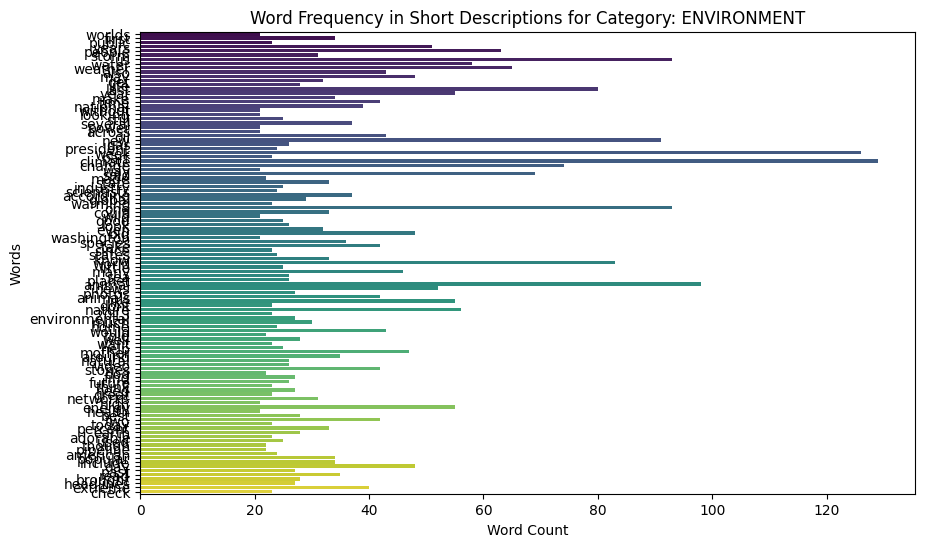

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


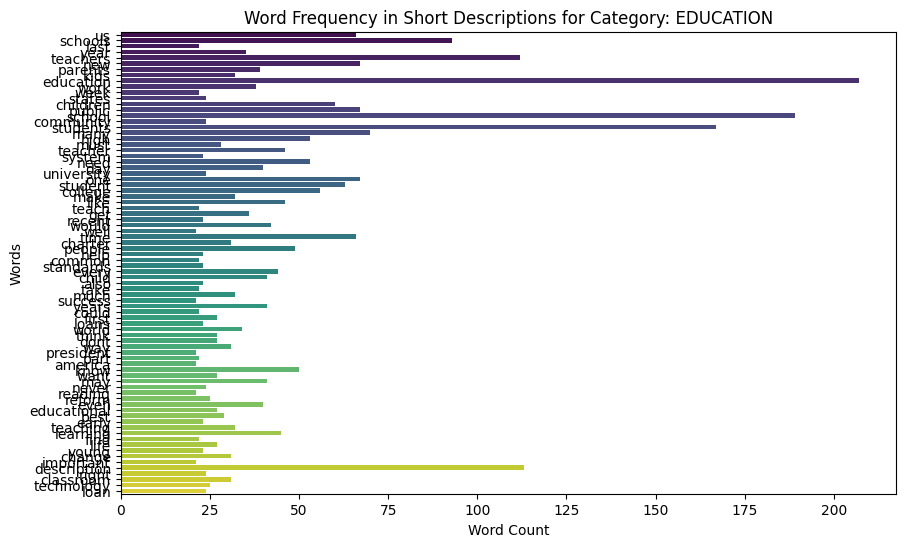

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


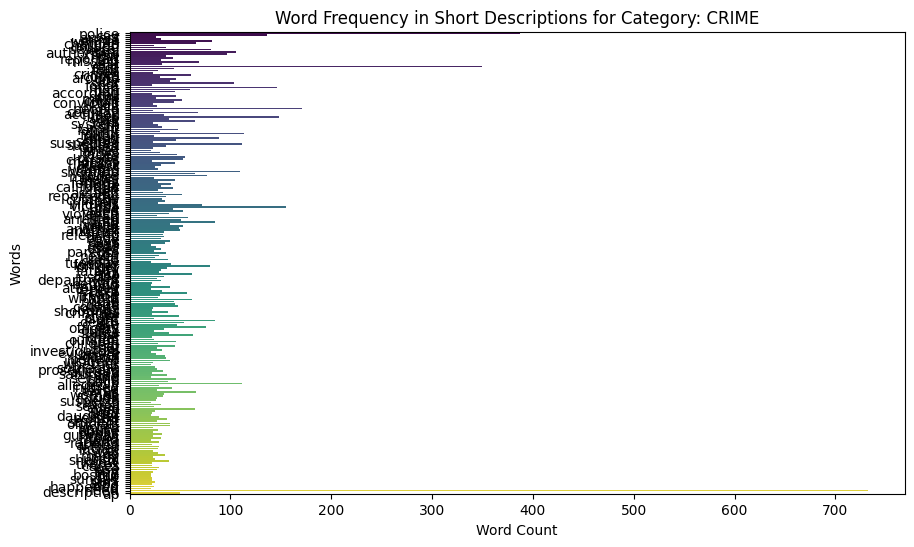

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


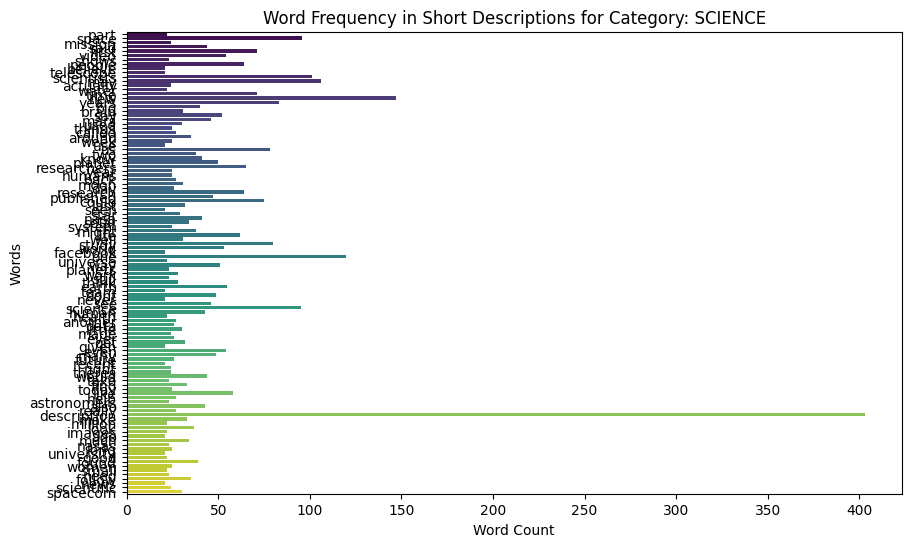

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


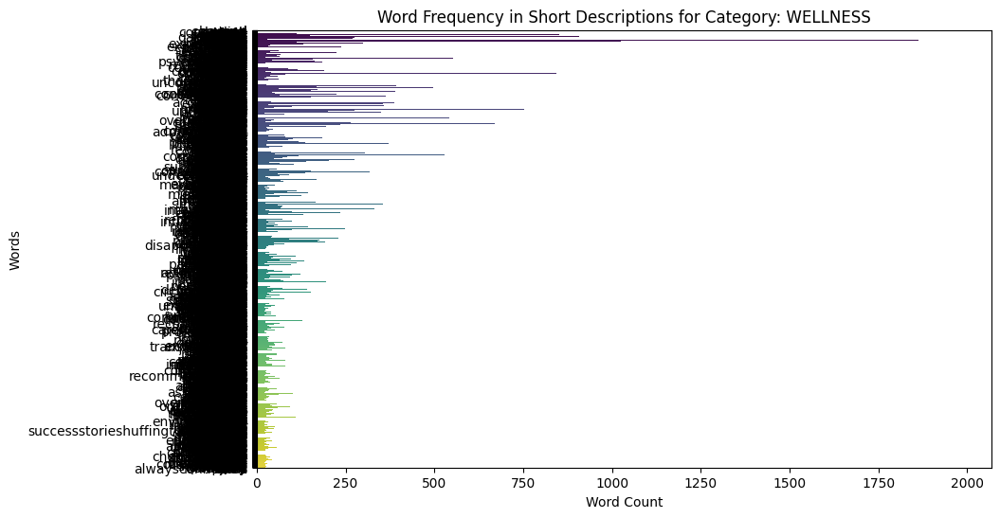

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


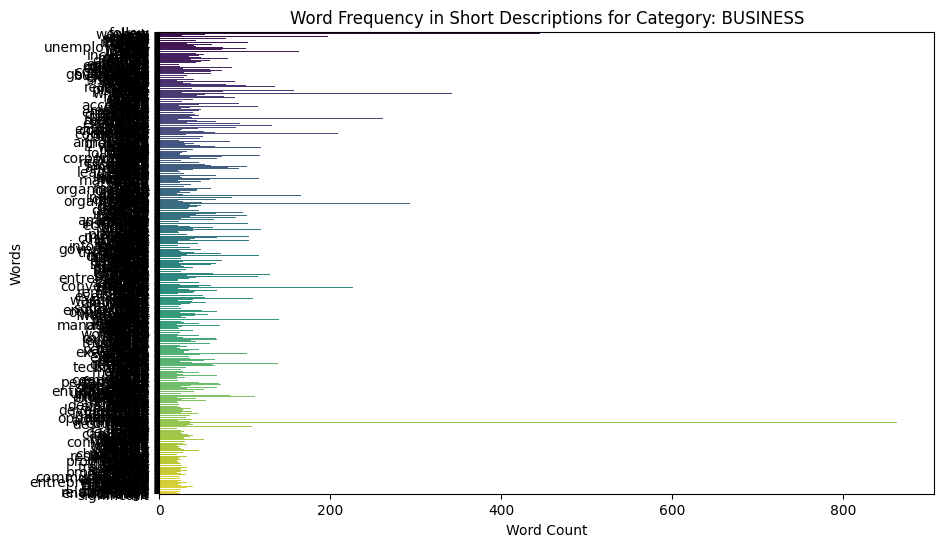

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


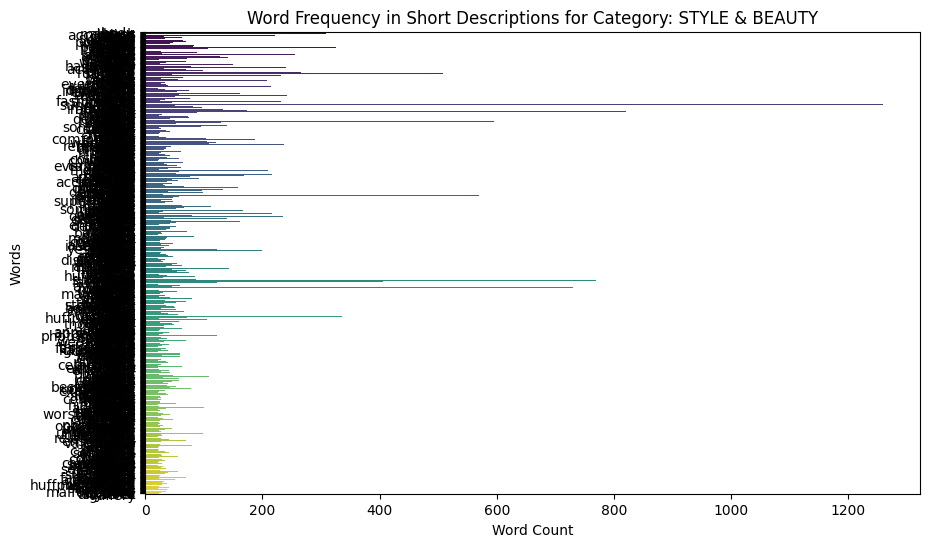

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


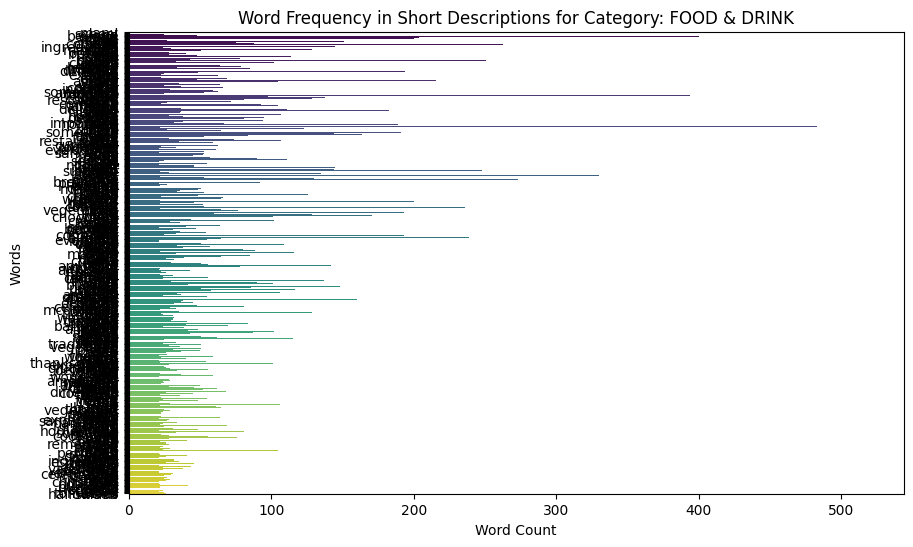

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


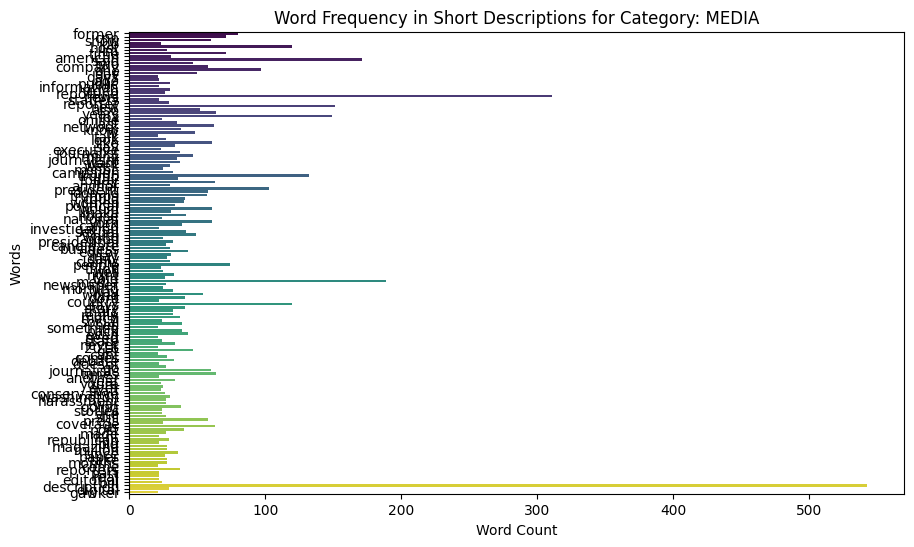

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


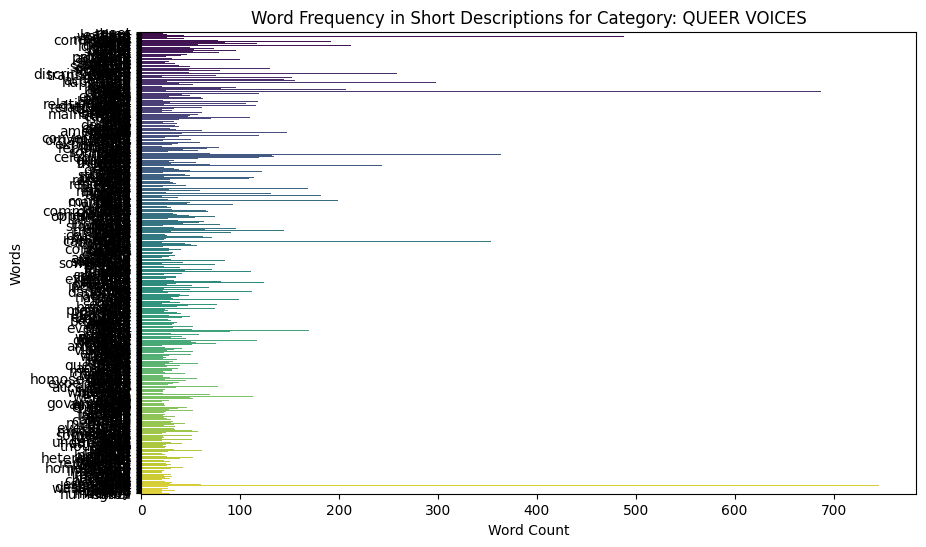

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


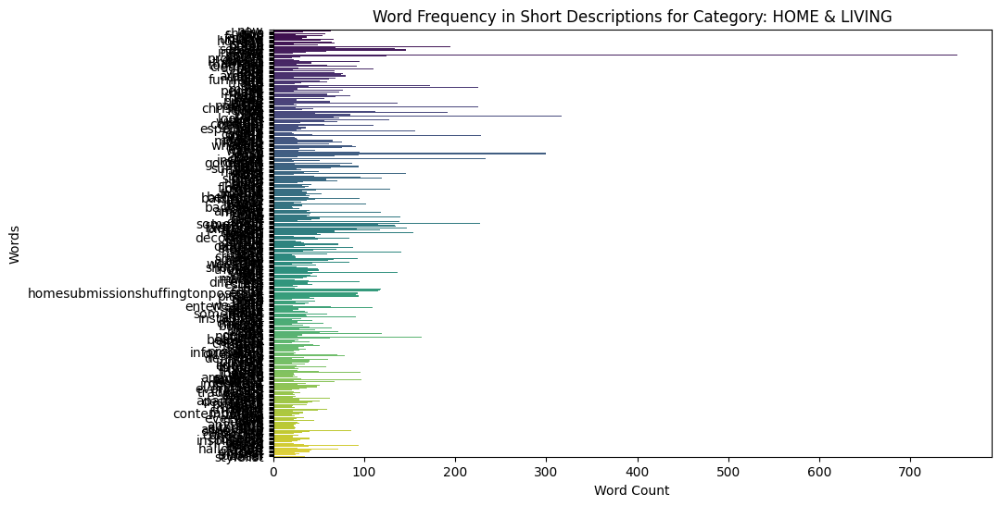

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


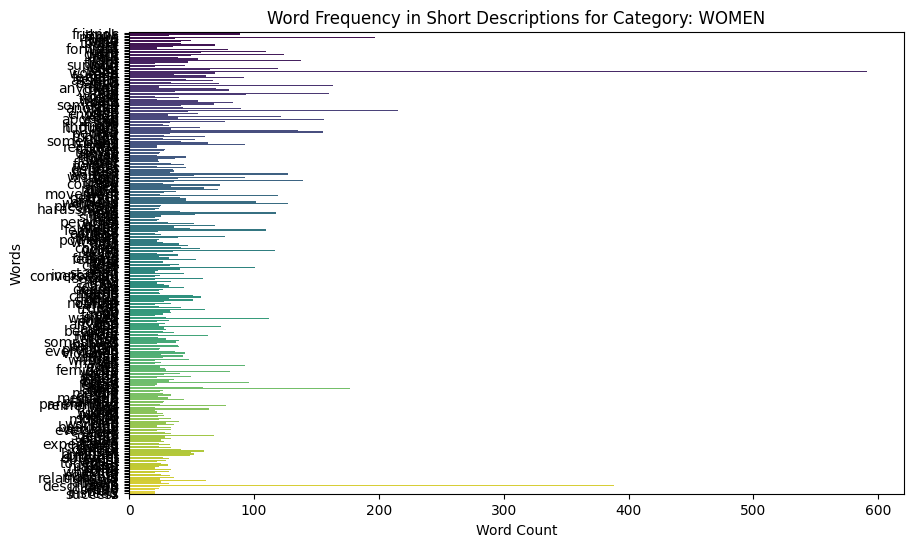

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


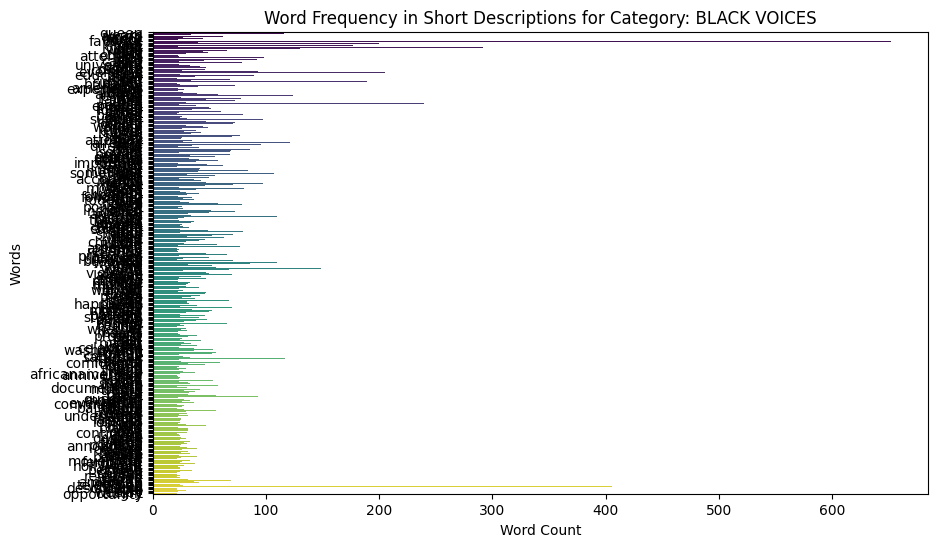

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


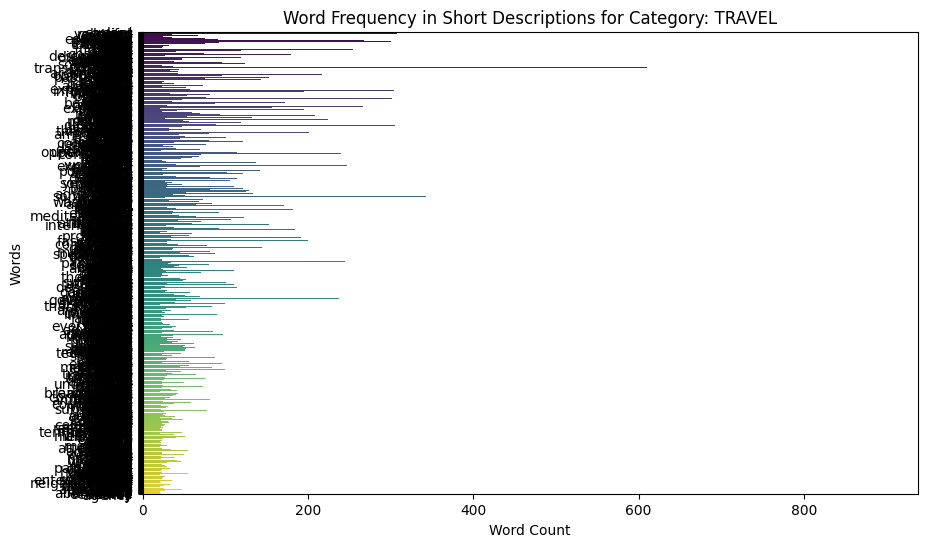

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


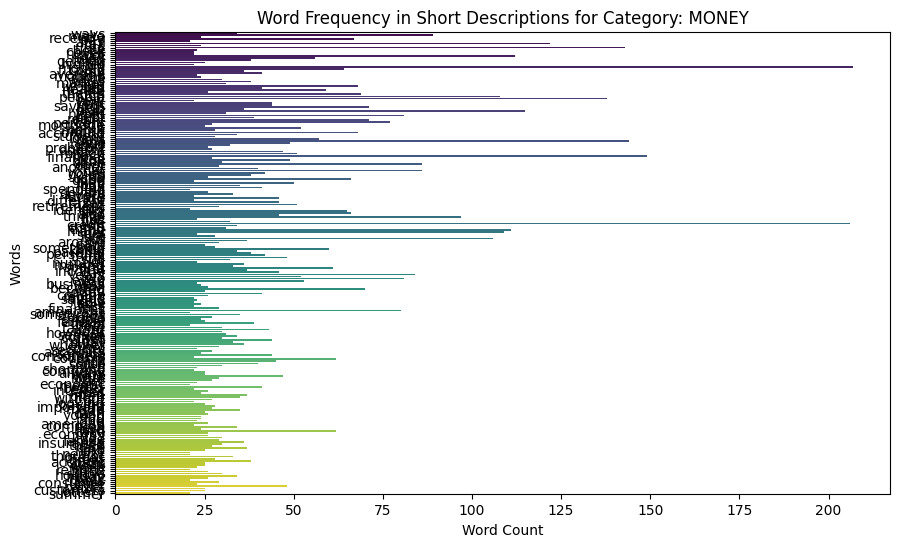

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


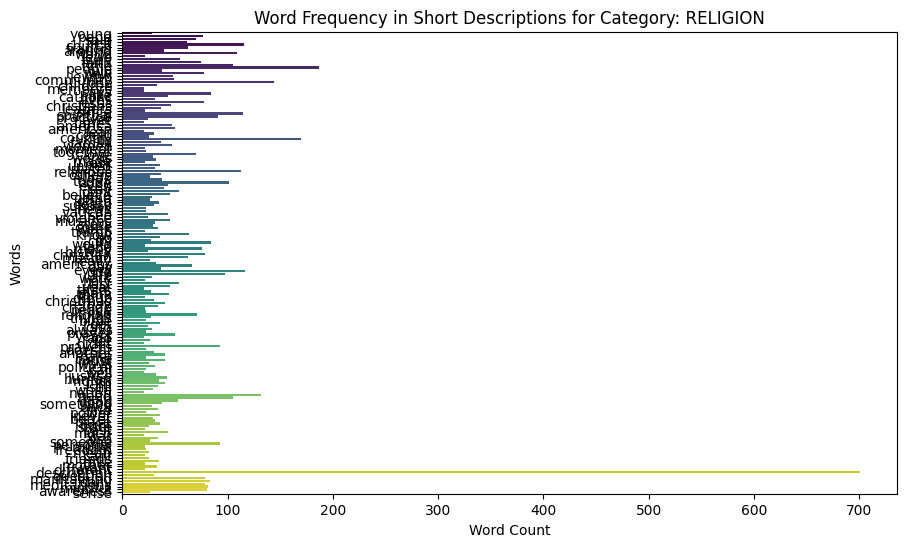

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


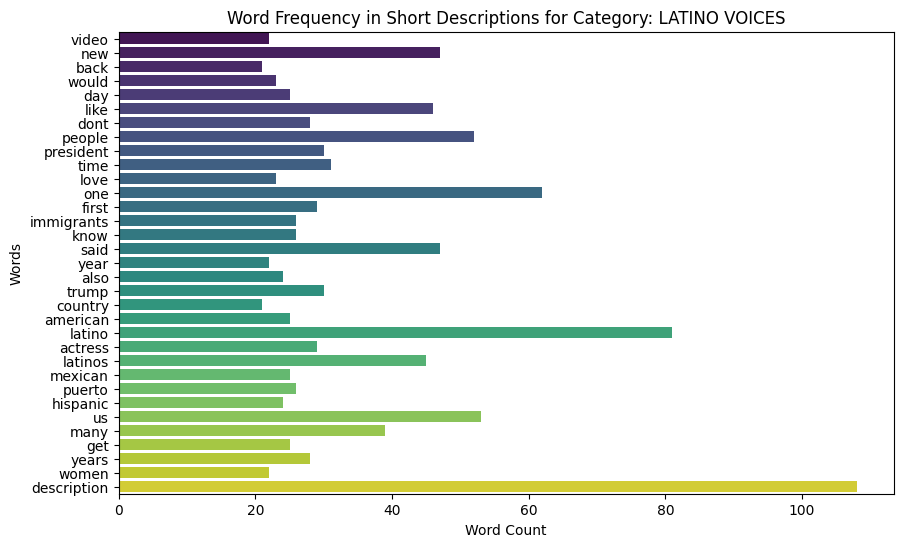

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


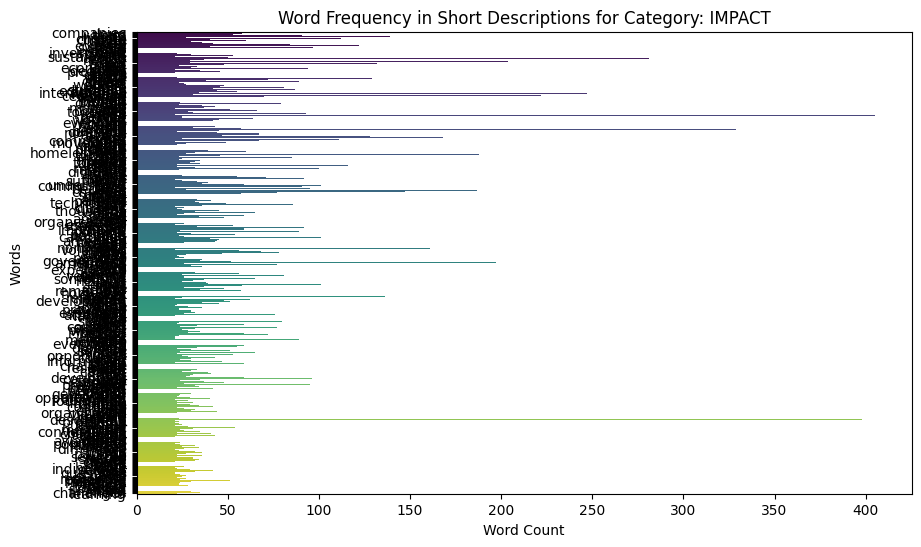

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


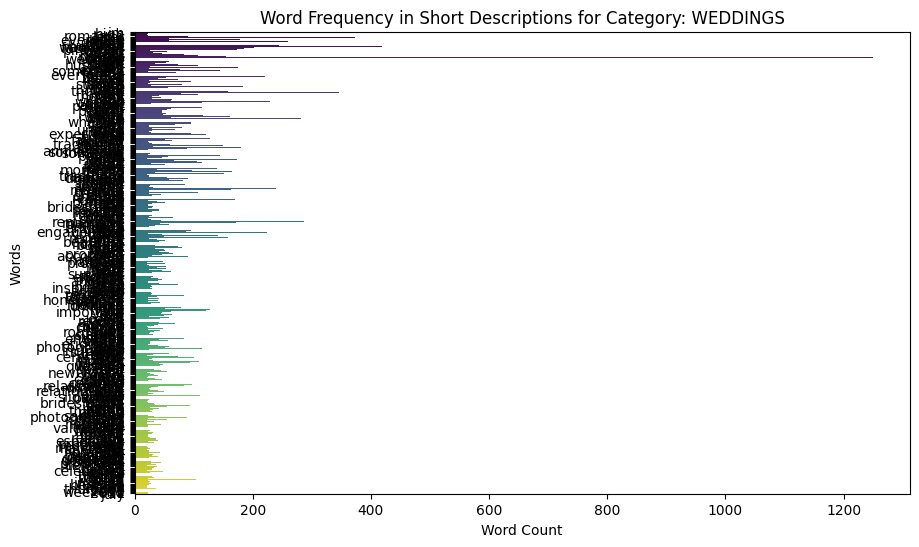

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


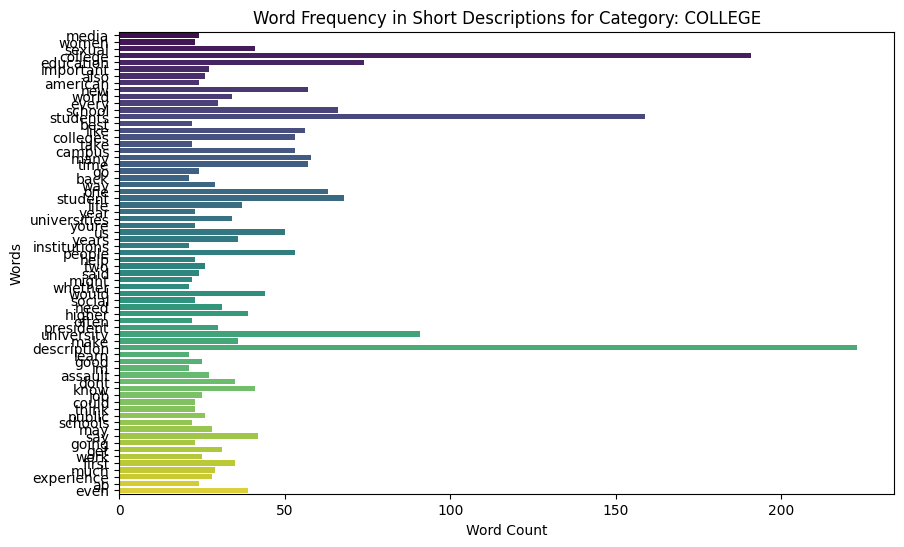

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


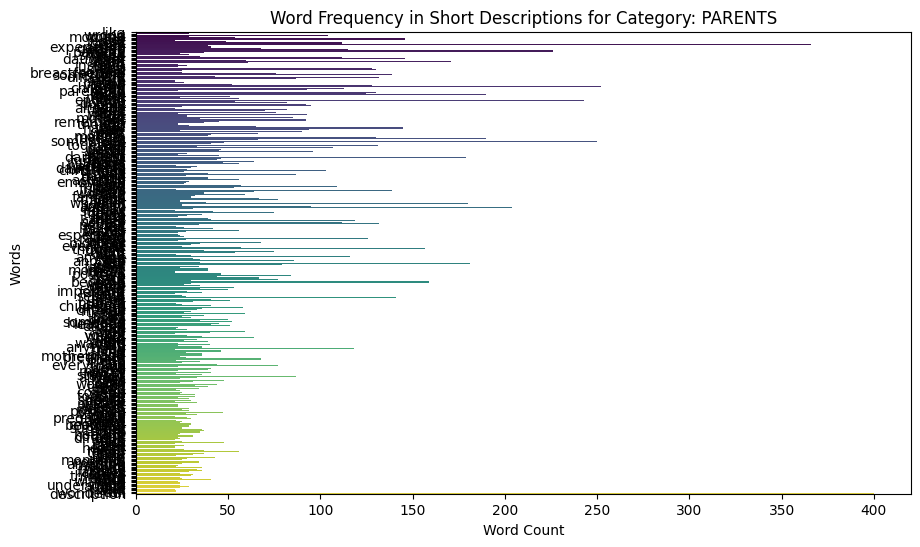

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


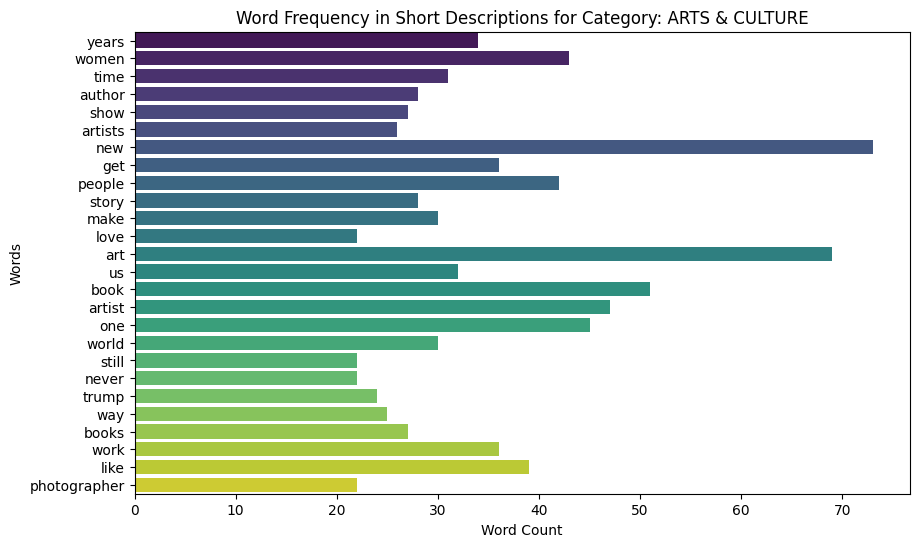

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


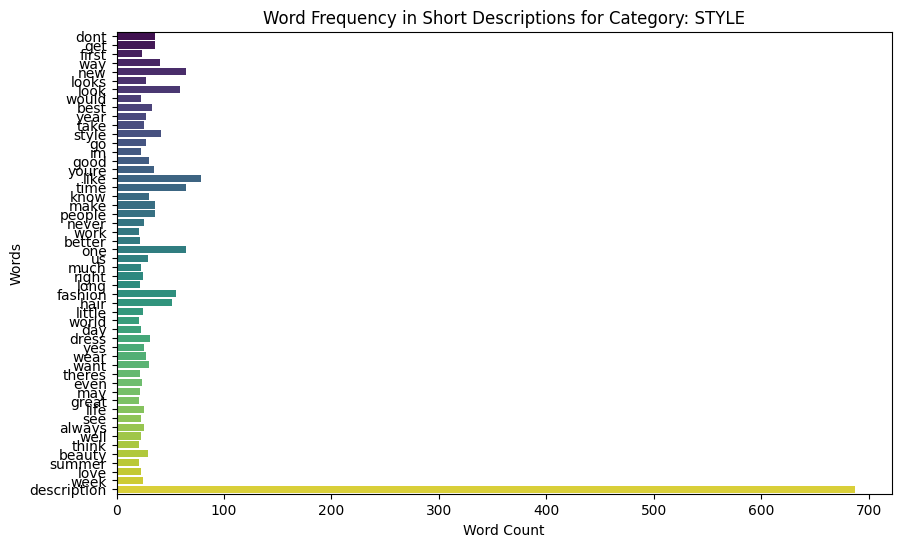

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


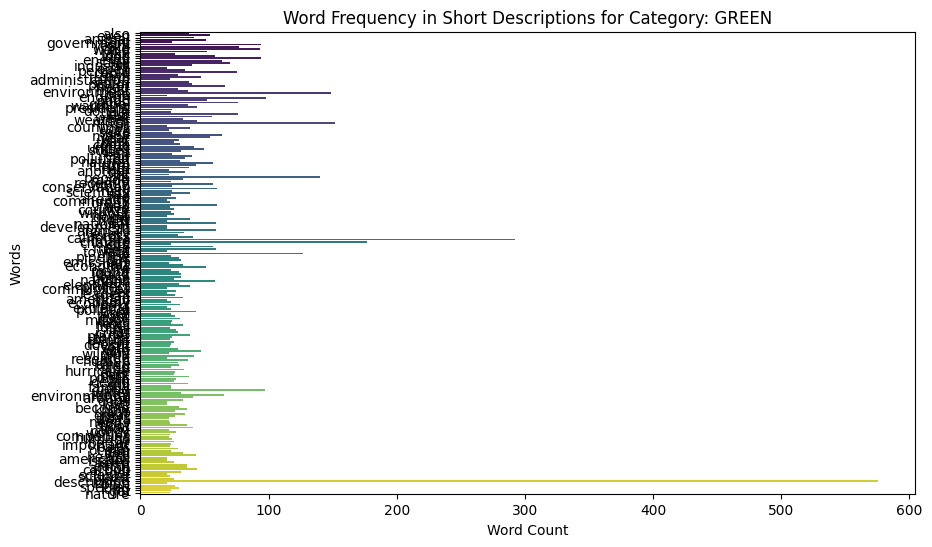

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


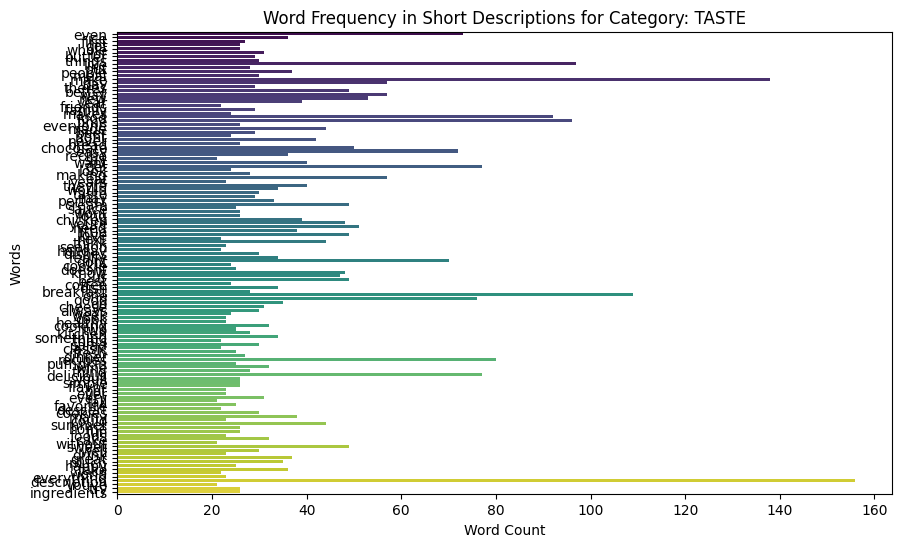

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


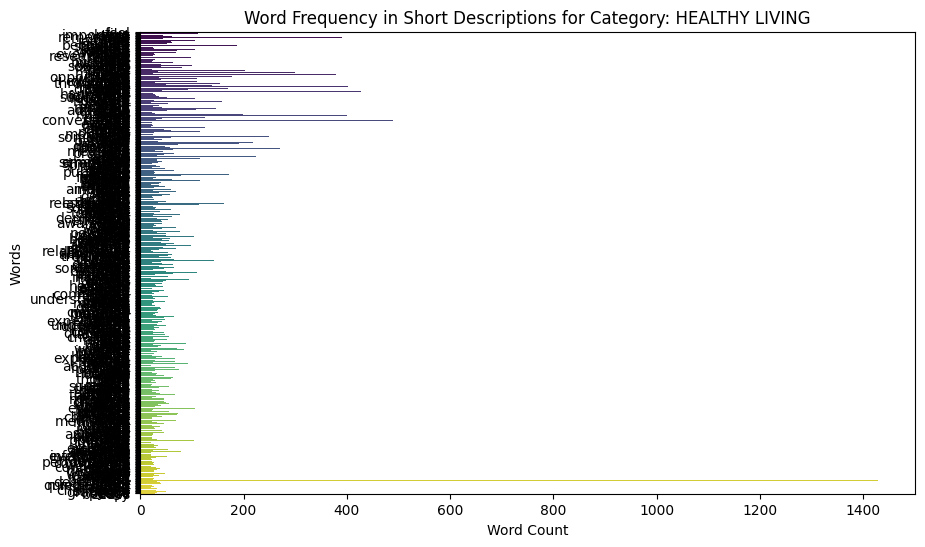

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


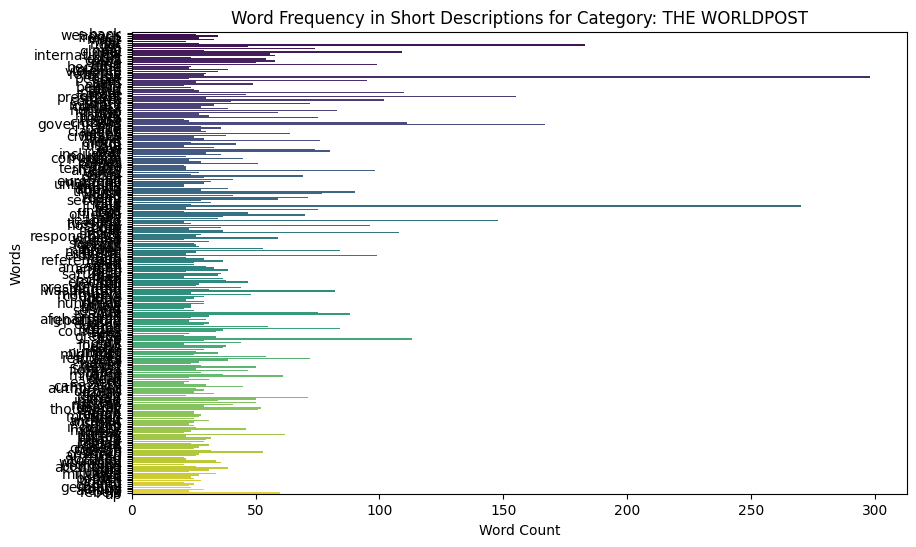

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


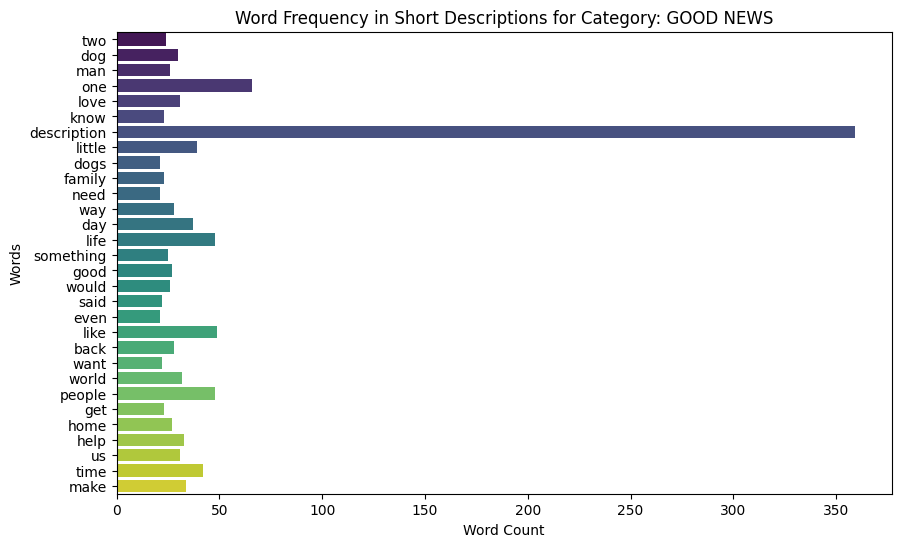

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


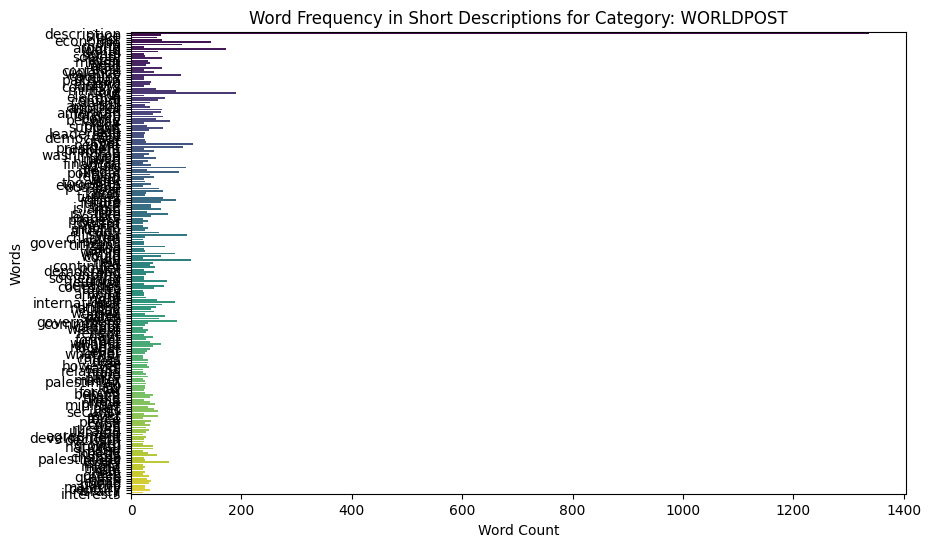

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


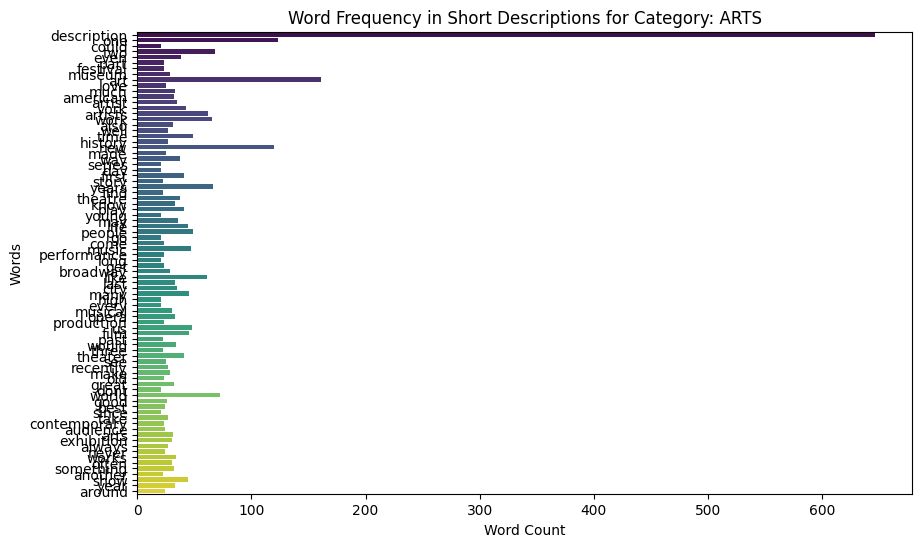

<ipython-input-40-fe5ef43a5a5a>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')


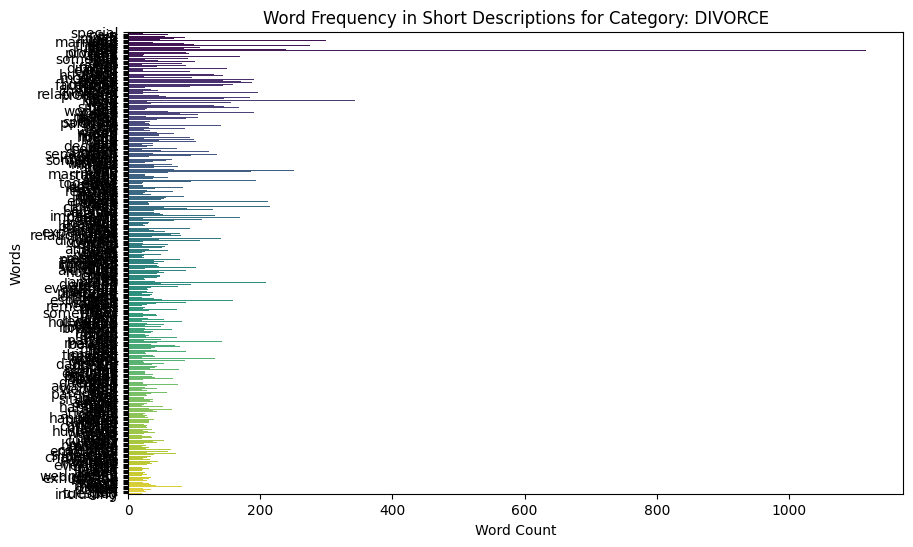

In [40]:
# Prepare to plot histograms for words that appear more than three times
for category, counts in word_counts.items():
    # Filter words that appear more than 3 times
    frequent_words = {word: count for word, count in counts.items() if count > 20}

    if frequent_words:  # Ensure there's at least one word to plot
        plt.figure(figsize=(10, 6))
        sns.barplot(x=list(frequent_words.values()), y=list(frequent_words.keys()), palette='viridis')
        plt.title(f'Word Frequency in Short Descriptions for Category: {category}')
        plt.xlabel('Word Count')
        plt.ylabel('Words')
        plt.show()

In [41]:
# Well the information we got above is really insightfull and helpful ,
# These common words will act as a major helper while training and predicting.

In [42]:
df['cleaned_text'] = df['headline'] + " " + df['short_description']

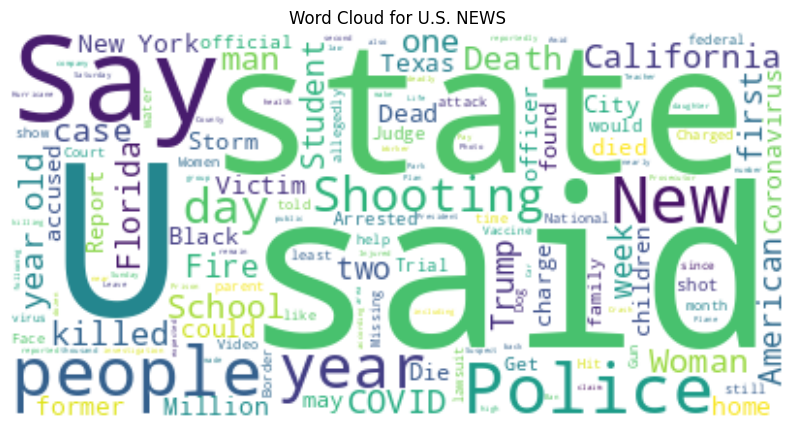

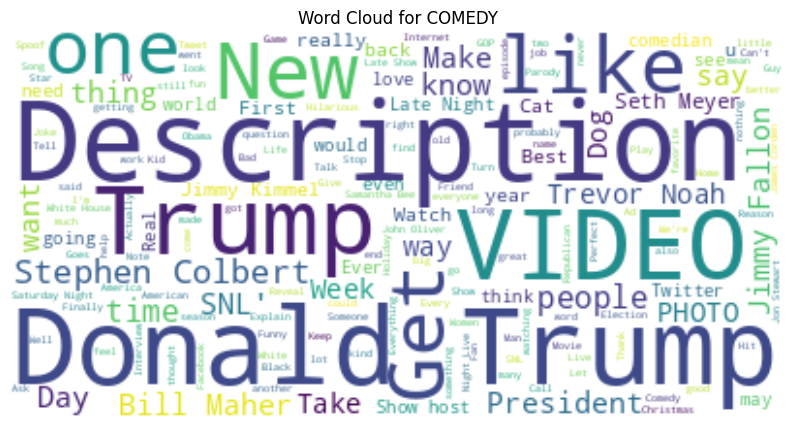

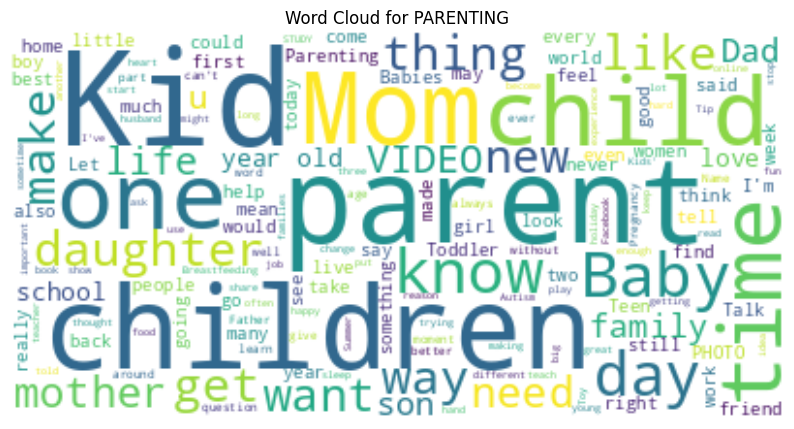

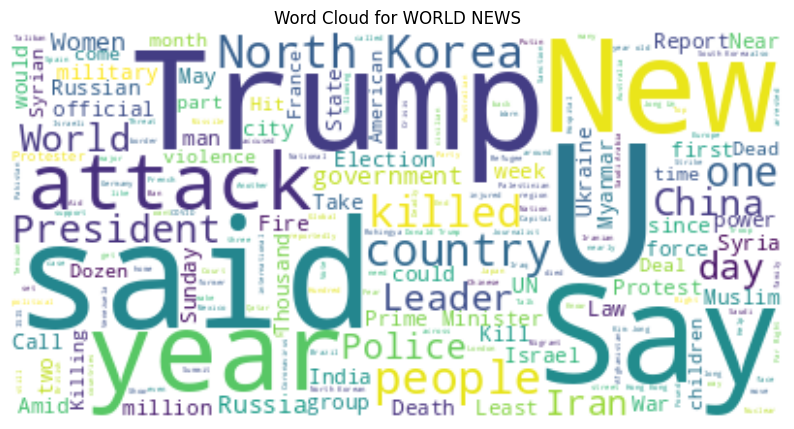

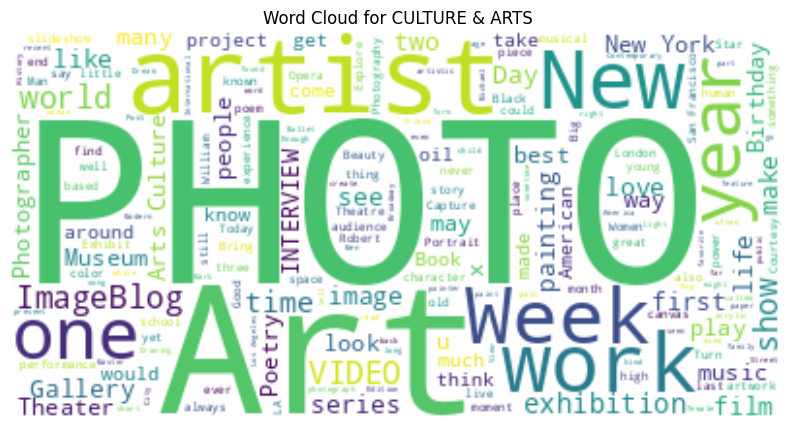

...

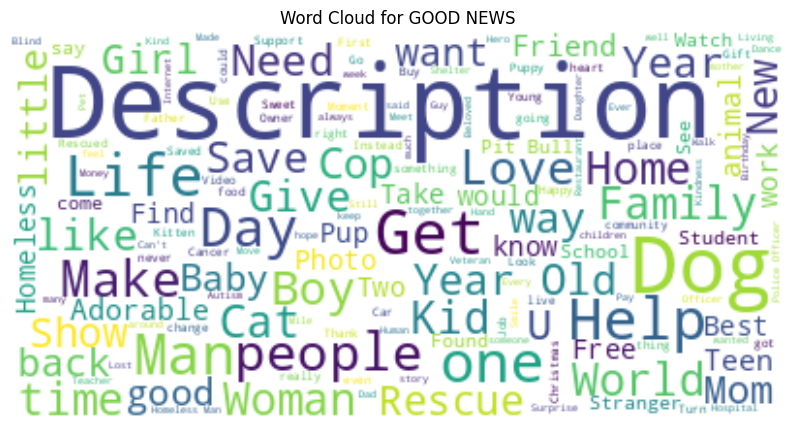

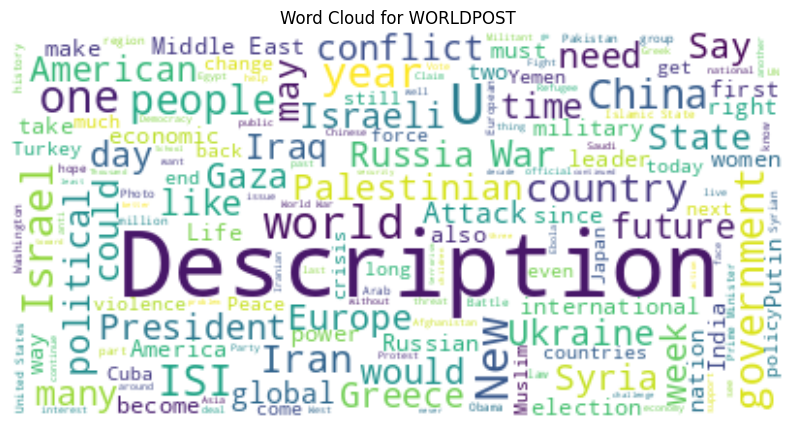

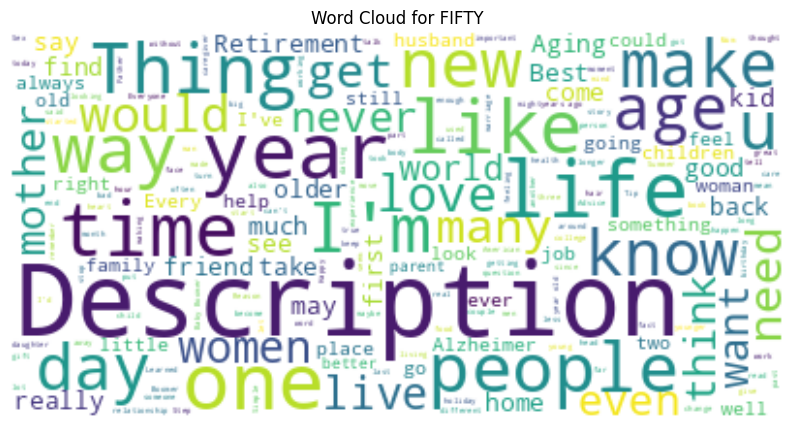

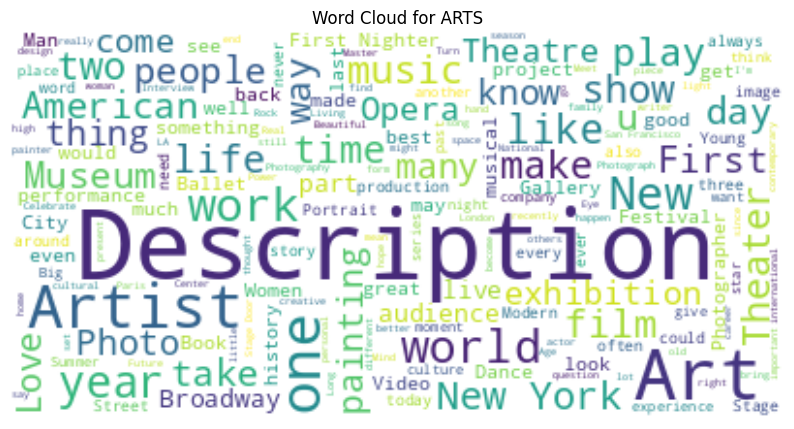

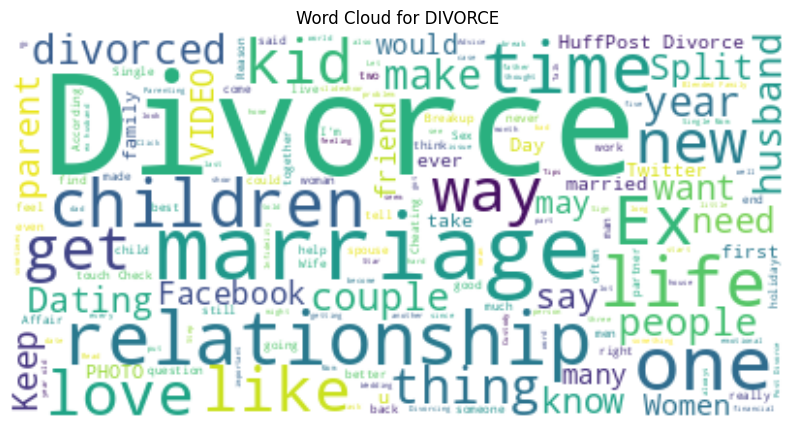

In [43]:
from wordcloud import WordCloud

for category in df['category'].unique():
    text = " ".join(df[df['category'] == category]['cleaned_text'])
    wordcloud = WordCloud(stopwords=stop_words, background_color='white').generate(text)
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"Word Cloud for {category}")
    plt.show()

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf = TfidfVectorizer(max_features=5000, stop_words='english')
X_text = tfidf.fit_transform(df['cleaned_text']).toarray()

# Save feature names for later use (e.g., to analyze feature importance)
feature_names = tfidf.get_feature_names_out()